# Desirable Neighborhoods in San Francisco
## By Vien Nguyen

### Introduction
A couple is moving into San Francisco, and they would like to pick their neighborhood based on several factors. They want to be close to nearby parks, restaurants, and public transit. They would also like the adjacent neighborhoods to be desirable as well. The target audience for this analysis are couples that value living near parks, food, and transit in the city of San Francisco.

### Business Problem
Can we build a model to recommend a neighborhood for the couple to live in, based on their specified criteria?

### Data
The data draws upon neighborhood data from a GeoJSON file available on DataSF, a publicly available source of municipal datasets. This data details San Francisco Neighborhoods as designated by the San Francisco Association of Realtors (SFAR) in August 2010. This data will define the boundaries of each neighborhood. The data also draws upon the venues given by the FourSquare API. The venue data includes the transit, park, and restaurant data that is important to the addressing the problem. Since there are many venue types, they will need to be consolidated into meaningful categories. For example, bus stops, train stations, and light rails all fall under transit.  We can use this data to rank the neighborhoods based on the problem criteria. We can also cluster the neighborhoods on the assumption that well-ranked adjacent neighborhoods will also be desirable in selecting a neighborhood to reside in.

In [1]:
# First let's import some mapping libraries
!conda install -c conda-forge geopy --yes 
from geopy.geocoders import Nominatim 
!conda install -c conda-forge folium=0.5.0 --yes 
import folium
!conda install -c conda-forge shapely --yes 
import shapely
from shapely import geometry
from sklearn.cluster import KMeans
import requests # library to handle requests
import pandas as pd # library for data analsysis
import numpy as np # library to handle data in a vectorized manner
# tranforming json file into a pandas dataframe library
from pandas.io.json import json_normalize
import json
from shapely.geometry import Polygon
from shapely.geometry import Point
import matplotlib.cm as cm
import matplotlib.colors as colors


print('Libraries imported.')

Fetching package metadata .............
Solving package specifications: .

# All requested packages already installed.
# packages in environment at /opt/conda/envs/DSX-Python35:
#
geopy                     1.18.1                     py_0    conda-forge
Fetching package metadata .............
Solving package specifications: .

# All requested packages already installed.
# packages in environment at /opt/conda/envs/DSX-Python35:
#
folium                    0.5.0                      py_0    conda-forge
Fetching package metadata .............
Solving package specifications: .

# All requested packages already installed.
# packages in environment at /opt/conda/envs/DSX-Python35:
#
shapely                   1.6.4            py35h164cb2d_1    conda-forge
Libraries imported.


## Data Collection

In [2]:
# Next we'll get the coordinates of San Francisco for the map
address = 'San Francisco, USA'

geolocator = Nominatim(user_agent="sf_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of San Francisco are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of San Francisco are 37.7792808, -122.4192363.


In [3]:
# Then we'll download the neighborhood data from DataSF
!wget --quiet "https://data.sfgov.org/api/geospatial/5gzd-g9ns?method=export&format=GeoJSON" -O sf.geojson

print('GeoJSON file downloaded!')

GeoJSON file downloaded!


In [4]:
# Now let's display the map
sf_map = folium.Map(location=[latitude, longitude], zoom_start=12)

sf_geo = r'sf.geojson'

sf_map.choropleth(
    geo_data=sf_geo,
    reset=True
)

sf_map

In [5]:
# Let's transform the GeoJSON into a dataframe with all the neighborhoods

with open('sf.geojson') as json_data:
    sf_data = json.load(json_data)
    
neighborhoods_data = sf_data['features']
column_names = ['Neighborhood', 'Latitude', 'Longitude'] 
neighborhoods = pd.DataFrame(columns=column_names)

# Since the GeoJSON file provides the neighborhood boundaries, we use shapely to calculate the center of each neighborhood
for data in neighborhoods_data:
    neighborhood_name = data['properties']['nbrhood']
    neighborhood_shape = Polygon(data['geometry']['coordinates'][0][0])
    neighborhood_latlon = neighborhood_shape.representative_point()
    neighborhood_lat = neighborhood_latlon.y
    neighborhood_lon = neighborhood_latlon.x
    neighborhoods = neighborhoods.append({'Neighborhood': neighborhood_name,
                                          'Latitude': neighborhood_lat,
                                          'Longitude': neighborhood_lon
                                          }, ignore_index=True)

neighborhoods.head()

,Neighborhood,Latitude,Longitude
0,Alamo Square,37.776076,-122.433919
1,Anza Vista,37.780611,-122.443255
2,Balboa Terrace,37.730649,-122.468267
3,Bayview,37.732391,-122.387170
4,Bernal Heights,37.740230,-122.415885


In [6]:
# Add markers to map
for lat, lng, label in zip(neighborhoods['Latitude'], 
                           neighborhoods['Longitude'], 
                           neighborhoods['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(sf_map)

sf_map

The following cells initialize our Foursquare API calls. In addition to my Foursquare developer credentials, the API call requires the latitude/longitude I calculated previously for each neighborhood. 

In [7]:
# The code was removed by Watson Studio for sharing.

In [8]:
# The code was removed by Watson Studio for sharing.

'https://api.foursquare.com/v2/venues/search?client_id=X2OJVIFXRCGI3IXCKWY1DWCH0MIKJY5AIXH42A05GRXEKP5I&client_secret=Y0XX43OFVGFX5SOJP5Y5MQQITULXXGFDKUY44LBA34XB0552&ll=37.7792808,-122.4192363&v=20180604&query=Bus Stop&radius=2000&limit=50'

In [9]:
results = requests.get(url).json()
results

{'meta': {'code': 200, 'requestId': '5c8994631ed2190c593ace3c'},
 'response': {'venues': [{'categories': [{'icon': {'prefix': 'https://ss3.4sqi.net/img/categories_v2/travel/busstation_',
       'suffix': '.png'},
      'id': '52f2ab2ebcbc57f1066b8b4f',
      'name': 'Bus Stop',
      'pluralName': 'Bus Stops',
      'primary': True,
      'shortName': 'Bus Stop'}],
    'hasPerk': False,
    'id': '4f6d0ddae4b0725b60d290e3',
    'location': {'address': 'Van Ness Ave',
     'cc': 'US',
     'city': 'San Francisco',
     'country': 'United States',
     'crossStreet': 'at McAllister St',
     'distance': 103,
     'formattedAddress': ['Van Ness Ave (at McAllister St)',
      'San Francisco, CA 94102',
      'United States'],
     'labeledLatLngs': [{'label': 'display',
       'lat': 37.779925625368705,
       'lng': -122.4200782149065}],
     'lat': 37.779925625368705,
     'lng': -122.4200782149065,
     'postalCode': '94102',
     'state': 'CA'},
    'name': 'MUNI Bus Stop - Van Ness & 

The following cell shows the response from Foursquare. There are many data fields available, but I will be mainly using the Category data in the subsequent analysis.

In [10]:
# assign relevant part of JSON to venues
venues = results['response']['venues']

# tranform venues into a dataframe
dataframe = json_normalize(venues)
dataframe.head()

,categories,hasPerk,id,location.address,location.cc,location.city,location.country,location.crossStreet,location.distance,location.formattedAddress,location.labeledLatLngs,location.lat,location.lng,location.postalCode,location.state,name,referralId
0,"[{'primary': True, 'shortName': 'Bus Stop', 'p...",False,4f6d0ddae4b0725b60d290e3,Van Ness Ave,US,San Francisco,United States,at McAllister St,103,"[Van Ness Ave (at McAllister St), San Francisc...","[{'lat': 37.779925625368705, 'lng': -122.42007...",37.779926,-122.420078,94102,CA,MUNI Bus Stop - Van Ness & McAllister,v-1552520291
1,"[{'primary': True, 'shortName': 'Bus Stop', 'p...",False,4b88065af964a520d6d931e3,O'Farrell St.,US,San Francisco,United States,at Van Ness Ave,636,"[O'Farrell St. (at Van Ness Ave), San Francisc...","[{'lat': 37.784726669123536, 'lng': -122.42143...",37.784727,-122.421437,94102,CA,MUNI Bus Stop - O'Farrell & Van Ness,v-1552520291
2,"[{'primary': True, 'shortName': 'Bus', 'plural...",False,4dd19466d22d67839c48d923,5th St North,US,San Francisco,United States,Market St,1112,"[5th St North (Market St), San Francisco, CA 9...","[{'lat': 37.78436889058537, 'lng': -122.408354...",37.784369,-122.408354,94102,CA,MUNI Bus Stop - 5th & Market,v-1552520291
3,"[{'primary': True, 'shortName': 'Bus Station',...",False,4bf8e22d5317a593938d007f,Market St.,US,San Francisco,United States,at 7th St.,625,"[Market St. (at 7th St.), San Francisco, CA 94...","[{'lat': 37.78063711787742, 'lng': -122.412336...",37.780637,-122.412337,94103,CA,MUNI Bus Stop - Market & 7th,v-1552520291
4,"[{'primary': True, 'shortName': 'Bus Station',...",False,4e51899a7d8bd425e4ad8bd9,Van Ness Ave.,US,San Francisco,United States,at Market St.,403,"[Van Ness Ave. (at Market St.), San Francisco,...","[{'lat': 37.77565734492292, 'lng': -122.419270...",37.775657,-122.419270,94102,CA,MUNI Bus Stop - Van Ness & Market,v-1552520291


Given that FourSquare return results within a distance of a lat/long point, we will need to determine whether a venue is actually within a neighborhood.

In [11]:
# Here we define a function that checks if a given point belongs to a neighborhood shape from the GeoJSON
def find_n (venue_point, neighborhoods_data):
    for data in neighborhoods_data:
        neighborhood_name = data['properties']['nbrhood']
        neighborhood_shape = Polygon(data['geometry']['coordinates'][0][0])
        if neighborhood_shape.contains(venue_point):
            return neighborhood_name;
    return None;

# We can now use the function to find the neighborhood of each of the venues in the FourSquare dataframe
for lat, lng in zip(dataframe['location.lat'], dataframe['location.lng']):
    venueloc = Point(lng,lat)   #Polygon uses longitude/latitude
    print(find_n(venueloc, neighborhoods_data))

Van Ness/Civic Center
Van Ness/Civic Center
Downtown
Van Ness/Civic Center
Van Ness/Civic Center
South of Market
South of Market
South of Market
Western Addition
Downtown
South of Market
Hayes Valley
Downtown
Downtown
Lower Pacific Heights
Hayes Valley
South of Market
Van Ness/Civic Center
Hayes Valley
Hayes Valley
South of Market
Downtown
Yerba Buena
Western Addition
Downtown
South of Market
Van Ness/Civic Center
South of Market
Downtown
Inner Mission
Downtown
Van Ness/Civic Center
Pacific Heights
Van Ness/Civic Center
Nob Hill
Van Ness/Civic Center
Tenderloin
South of Market
Van Ness/Civic Center
Downtown
Western Addition
Inner Mission
Downtown
Hayes Valley
Haight Ashbury
Van Ness/Civic Center
Hayes Valley
Duboce Triangle
Inner Mission
Van Ness/Civic Center


The FourSquare API has a 50 result limit for each request. I can get around this limit by making multiple calls per neighborhood, for specific categories that are important for this analysis. I use these Category IDs within the API call.

**Arts & Entertainment**
4d4b7104d754a06370d81259

**Food**
4d4b7105d754a06374d81259

**Outdoors & Recreation**
4d4b7105d754a06377d81259

**Shop & Service**
4d4b7105d754a06378d81259

**Bus Station**
4bf58dd8d48988d1fe931735

**Bus Stop**
52f2ab2ebcbc57f1066b8b4f

**Cable Car**
52f2ab2ebcbc57f1066b8b50

**Light Rail Station**
4bf58dd8d48988d1fc931735

**Metro Station**
4bf58dd8d48988d1fd931735

**Train Station**
4bf58dd8d48988d129951735

**Tram Station**
52f2ab2ebcbc57f1066b8b51

In [12]:
categories_list = {'4d4b7104d754a06370d81259': 'Arts & Entertainment',
'4d4b7105d754a06374d81259': 'Food', 
'4d4b7105d754a06377d81259': 'Outdoors & Recreation', 
'4d4b7105d754a06378d81259': 'Shop & Service',
'4bf58dd8d48988d1fe931735': 'Transit', #Bus Station 
'52f2ab2ebcbc57f1066b8b4f': 'Transit', #Bus Stop 
'52f2ab2ebcbc57f1066b8b50': 'Transit', #Cable Car 
'4bf58dd8d48988d1fc931735': 'Transit', #Light Rail Station 
'4bf58dd8d48988d1fd931735': 'Transit', #Metro Station 
'4bf58dd8d48988d129951735': 'Transit', #Train Station 
'52f2ab2ebcbc57f1066b8b51': 'Transit'} #Tram Station 

def getNearbyVenues(names, latitudes, longitudes, radius=2000): #borrowed from this course's week 3 lab, modified to check categories
    x = 0
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        for id, category in categories_list.items():
        # create the API request URL
            url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
                CLIENT_ID, 
                CLIENT_SECRET, 
                VERSION, 
                lat, 
                lng, 
                radius, 
                LIMIT,
                id)            

            try: # try the GET request, exception occurs when there is a warning
                results = requests.get(url).json()["response"]['groups'][0]['items']
            except:
                try: #sometimes the first request fails, but calling it again seems to resolve the issue
                    results=requests.get(url).json()["response"]['groups'][0]['items']
                except:
                    print('API Call for ',lat,lng, 'failed')
                    print(url)
                    print(requests.get(url).json()["response"]['groups'][0]['items'])

            try:
                venues_list.append([(
                    name, 
                    lat, 
                    lng, 
                    v['venue']['name'], 
                    v['venue']['location']['lat'], 
                    v['venue']['location']['lng'],  
                    v['venue']['categories'][0]['name'],
                    category) for v in results])
            except:
                try:
                    venues_list.append([(
                        name, 
                        lat, 
                        lng, 
                        v[0]['venue']['name'], 
                        v[0]['venue']['location']['lat'], 
                        v[0]['venue']['location']['lng'],  
                        v[0]['venue']['categories'][0]['name'],
                        category) for v in results])
                except:
                    print('Append for ',lat,lng,name,category, 'failed', id)
                    print(url)

            x = x + 1
    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category',
                  'Master Category']
    print('API calls: ',x)
    return(nearby_venues)

In [13]:
# type your answer here

sf_venues1 = getNearbyVenues(names=neighborhoods['Neighborhood'],
                                   latitudes=neighborhoods['Latitude'],
                                   longitudes=neighborhoods['Longitude']
                                  )
sf_venues2 = getNearbyVenues(names=neighborhoods['Neighborhood'],
                                   latitudes=neighborhoods['Latitude'],
                                   longitudes=neighborhoods['Longitude'],
                                   radius=500
                                  ) # This second call is made to address small neighborhoods that would not get any results if the radius is too large
sf_venues = pd.concat([sf_venues1,sf_venues2])
sf_venues.head()

Append for  37.76047887250134 -122.39933265130747 Potrero Hill Transit failed 4bf58dd8d48988d1fd931735
https://api.foursquare.com/v2/venues/explore?&client_id=X2OJVIFXRCGI3IXCKWY1DWCH0MIKJY5AIXH42A05GRXEKP5I&client_secret=Y0XX43OFVGFX5SOJP5Y5MQQITULXXGFDKUY44LBA34XB0552&v=20180604&ll=37.76047887250134,-122.39933265130747&radius=2000&limit=50&categoryId=4bf58dd8d48988d1fd931735
Append for  37.75742616557252 -122.38678010700755 Central Waterfront/Dogpatch Transit failed 4bf58dd8d48988d1fd931735
https://api.foursquare.com/v2/venues/explore?&client_id=X2OJVIFXRCGI3IXCKWY1DWCH0MIKJY5AIXH42A05GRXEKP5I&client_secret=Y0XX43OFVGFX5SOJP5Y5MQQITULXXGFDKUY44LBA34XB0552&v=20180604&ll=37.75742616557252,-122.38678010700755&radius=2000&limit=50&categoryId=4bf58dd8d48988d1fd931735
API calls:  1012
API calls:  1012


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Master Category
0,Alamo Square,37.776076,-122.433919,The Metro Hotel,37.772487,-122.437437,Hotel,Transit
1,Alamo Square,37.776076,-122.433919,Metro Caffe,37.771909,-122.430418,Burger Joint,Transit
2,Alamo Square,37.776076,-122.433919,Church Cross (Church & Market),37.767560,-122.428883,Metro Station,Transit
3,Alamo Square,37.776076,-122.433919,Metro by T-Mobile,37.783158,-122.432374,Mobile Phone Shop,Transit
4,Alamo Square,37.776076,-122.433919,Civic Center/UN Plaza BART Station,37.779300,-122.414514,Metro Station,Transit


In [14]:
sf_venues.shape

(36428, 8)

We see above from the function output that the FourSquare API occasionally returns warnings, which usually occurs when there are no or few results. This means some of the results will not go into our analysis, so our Foursquare data will change depending on how often these warnings are issued.

## Data Understanding

We can group the result set by neighborhood to see how many venues were returned from each neighborhood query.

In [15]:
sf_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Master Category
Neighborhood,,,,,,,
Alamo Square,547,547,547,547,547,547,547
Anza Vista,437,437,437,437,437,437,437
Balboa Terrace,317,317,317,317,317,317,317
Bayview,259,259,259,259,259,259,259
Bayview Heights,209,209,209,209,209,209,209
Bernal Heights,383,383,383,383,383,383,383
Buena Vista Park/Ashbury Heights,483,483,483,483,483,483,483
Candlestick Point,158,158,158,158,158,158,158
Central Richmond,425,425,425,425,425,425,425


Next we'll uses the pandas describe function to see where we'll need to clean up the data. Notice how the unique values are quite low compared to the count.

In [16]:
sf_venues.describe(include=object)

,Neighborhood,Venue,Venue Category,Master Category
count,36428,36428,36428,36428
unique,92,8514,364,5
top,Yerba Buena,Metro by T-Mobile,Light Rail Station,Transit
freq,713,140,3351,13397


## Data Preparation

Since the FourSquare API returns all results within 2000m of each of our neighborhood centers, smaller neighborhoods may have been assigned results from other neighborhoods. I run the *find_n* function against each row of the *sf_venues* dataframe to determine if the result is actually in that neighborhood.

In [17]:
sf_venues['Neighborhood'] = sf_venues.apply(lambda row: find_n(Point(row['Venue Longitude'],row['Venue Latitude']),neighborhoods_data), axis=1)

In [18]:
sf_venues.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Master Category
0,Haight Ashbury,37.776076,-122.433919,The Metro Hotel,37.772487,-122.437437,Hotel,Transit
1,Hayes Valley,37.776076,-122.433919,Metro Caffe,37.771909,-122.430418,Burger Joint,Transit
2,Duboce Triangle,37.776076,-122.433919,Church Cross (Church & Market),37.767560,-122.428883,Metro Station,Transit
3,Western Addition,37.776076,-122.433919,Metro by T-Mobile,37.783158,-122.432374,Mobile Phone Shop,Transit
4,Van Ness/Civic Center,37.776076,-122.433919,Civic Center/UN Plaza BART Station,37.779300,-122.414514,Metro Station,Transit


In [19]:
sf_nodupe = sf_venues.drop_duplicates(['Venue','Venue Latitude','Venue Longitude'])
sf_nodupe.shape

(9067, 8)

In [20]:
sf_nodupe = sf_nodupe.dropna(subset=['Neighborhood']) #This drops results outside of SF boundaries
sf_nodupe.shape

(8941, 8)

In [21]:
print(sf_venues.shape)
print(sf_nodupe.shape)

(36428, 8)
(8941, 8)


We see that a large number of venues are removed after we check whether they are actually in the neighborhood. We can also look at how many venues are in each category.

In [22]:
print('Outdoors & Recreation:',sf_nodupe.loc[sf_nodupe['Master Category']=='Outdoors & Recreation','Master Category'].agg('count'))
print('Food:',sf_nodupe.loc[sf_nodupe['Master Category']=='Food','Master Category'].agg('count'))
print('Transit:',sf_nodupe.loc[sf_nodupe['Master Category']=='Transit','Master Category'].agg('count'))
print('Arts & Entertainment:',sf_nodupe.loc[sf_nodupe['Master Category']=='Arts & Entertainment','Master Category'].agg('count'))
print('Shop & Service:',sf_nodupe.loc[sf_nodupe['Master Category']=='Shop & Service','Master Category'].agg('count'))

Outdoors & Recreation: 1526
Food: 2078
Transit: 1821
Arts & Entertainment: 939
Shop & Service: 2577


Next we'll add the venues to our map to see the geographical distribution of our venues.

In [23]:
# Add markers to map
venue_color = {'Outdoors & Recreation':'green',
               'Food':'red',
               'Transit':'black',
               'Shop & Service':'yellow',
               'Arts & Entertainment':'orange'}

for lat, lng, label in zip(sf_nodupe['Venue Latitude'], sf_nodupe['Venue Longitude'], sf_nodupe['Master Category']):
    temp_color = venue_color[label]
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color=temp_color,
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(sf_map)  

sf_map

Next we'll use one hot encoding to determine the frequency of each category in regards to the total number of venues in each neighborhood.

In [24]:
# one hot encoding
sf_onehot = pd.get_dummies(sf_nodupe[['Master Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
sf_onehot['Neighborhood'] = sf_nodupe['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [sf_onehot.columns[-1]] + list(sf_onehot.columns[:-1])
sf_onehot = sf_onehot[fixed_columns]

sf_onehot.head()

,Neighborhood,Arts & Entertainment,Food,Outdoors & Recreation,Shop & Service,Transit
0,Haight Ashbury,0,0,0,0,1
1,Hayes Valley,0,0,0,0,1
2,Duboce Triangle,0,0,0,0,1
3,Western Addition,0,0,0,0,1
4,Van Ness/Civic Center,0,0,0,0,1


In [25]:
sf_grouped = sf_onehot.groupby('Neighborhood').mean().reset_index()
sf_grouped.head()

,Neighborhood,Arts & Entertainment,Food,Outdoors & Recreation,Shop & Service,Transit
0,Alamo Square,0.090000,0.260000,0.100000,0.360000,0.190000
1,Anza Vista,0.000000,0.107143,0.000000,0.714286,0.178571
2,Balboa Terrace,0.125000,0.125000,0.000000,0.625000,0.125000
3,Bayview,0.059459,0.243243,0.108108,0.470270,0.118919
4,Bayview Heights,0.272727,0.181818,0.272727,0.090909,0.181818


In [26]:
sf_map_art = folium.Map(location=[latitude, longitude], zoom_start=12)

sf_map_art.choropleth(
    data=sf_grouped,
    geo_data=sf_geo,
    reset=True,
    name='choropleth',
    columns=['Neighborhood','Arts & Entertainment'],
    key_on='feature.properties.nbrhood',
    fill_color='OrRd',
    legend_name='Arts & Entertainment Prevalance',
    highlight=True
)

# Add markers to map
for lat, lng, label in zip(neighborhoods['Latitude'], 
                           neighborhoods['Longitude'], 
                           neighborhoods['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(sf_map_art)

sf_map_art

In [27]:
sf_map_food = folium.Map(location=[latitude, longitude], zoom_start=12)

sf_map_food.choropleth(
    data=sf_grouped,
    geo_data=sf_geo,
    reset=True,
    name='choropleth',
    columns=['Neighborhood','Food'],
    key_on='feature.properties.nbrhood',
    fill_color='PuRd',
    legend_name='Food Prevalence',
    highlight=True
)

# Add markers to map
for lat, lng, label in zip(neighborhoods['Latitude'], 
                           neighborhoods['Longitude'], 
                           neighborhoods['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(sf_map_food)

sf_map_food

In [28]:
sf_map_rec = folium.Map(location=[latitude, longitude], zoom_start=12)

sf_map_rec.choropleth(
    data=sf_grouped,
    geo_data=sf_geo,
    reset=True,
    name='choropleth',
    columns=['Neighborhood','Outdoors & Recreation'],
    key_on='feature.properties.nbrhood',
    fill_color='YlGn',
    legend_name='Outdoors & Recreation Prevalance',
    highlight=True
)

# Add markers to map
for lat, lng, label in zip(neighborhoods['Latitude'], 
                           neighborhoods['Longitude'], 
                           neighborhoods['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(sf_map_rec)

sf_map_rec

In [29]:
sf_map_shop = folium.Map(location=[latitude, longitude], zoom_start=12)

sf_map_shop.choropleth(
    data=sf_grouped,
    geo_data=sf_geo,
    reset=True,
    name='choropleth',
    columns=['Neighborhood','Shop & Service'],
    key_on='feature.properties.nbrhood',
    fill_color='YlOrBr',
    legend_name='Shop & Service Prevalence',
    highlight=True
)

# Add markers to map
for lat, lng, label in zip(neighborhoods['Latitude'], 
                           neighborhoods['Longitude'], 
                           neighborhoods['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(sf_map_shop)

sf_map_shop

In [30]:
sf_map_transit = folium.Map(location=[latitude, longitude], zoom_start=12)

sf_map_transit.choropleth(
    data=sf_grouped,
    geo_data=sf_geo,
    reset=True,
    name='choropleth',
    columns=['Neighborhood','Transit'],
    key_on='feature.properties.nbrhood',
    fill_color='Greys',
    legend_name='Transit Prevalence',
    highlight=True
)

# Add markers to map
for lat, lng, label in zip(neighborhoods['Latitude'], 
                           neighborhoods['Longitude'], 
                           neighborhoods['Neighborhood']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(sf_map_transit)

sf_map_transit

The 5 maps show above visualize the general distribution of our venue results across the city of San Francisco. The darker areas represent where that particular venue category is prevalent.

## Modeling

In the following cells I use the k-means clustering technique to group similar neighborhoods. In this first analysis, I use a similiar method as the Week 3 lab. The clusters will be based on the 5 categories which I've identified in the dataset.

In [31]:
# Borrowed from Week 3 Lab
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [32]:
# Borrowed from Week 3 Lab
num_top_venues = 5

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = sf_grouped['Neighborhood']

for ind in np.arange(sf_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(sf_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,Alamo Square,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment
1,Anza Vista,Shop & Service,Transit,Food,Outdoors & Recreation,Arts & Entertainment
2,Balboa Terrace,Shop & Service,Transit,Food,Arts & Entertainment,Outdoors & Recreation
3,Bayview,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment
4,Bayview Heights,Outdoors & Recreation,Arts & Entertainment,Transit,Food,Shop & Service


Now with the frequencies of each category, we can run k-means clustering to group the neighborhoods.

In [33]:
# set number of clusters
kclusters = 5

sf_grouped_clustering = sf_grouped.drop('Neighborhood', 1)
print(sf_grouped_clustering.head())
# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(sf_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:] 

   Arts & Entertainment      Food  Outdoors & Recreation  Shop & Service  \
0              0.090000  0.260000               0.100000        0.360000   
1              0.000000  0.107143               0.000000        0.714286   
2              0.125000  0.125000               0.000000        0.625000   
3              0.059459  0.243243               0.108108        0.470270   
4              0.272727  0.181818               0.272727        0.090909   

    Transit  
0  0.190000  
1  0.178571  
2  0.125000  
3  0.118919  
4  0.181818  


array([4, 2, 2, 2, 1, 4, 3, 1, 4, 4, 4, 3, 0, 1, 0, 2, 0, 0, 0, 4, 4, 0, 0,
       3, 1, 0, 1, 1, 2, 4, 4, 4, 1, 2, 0, 2, 4, 4, 2, 1, 0, 4, 1, 0, 4, 4,
       4, 1, 2, 1, 4, 4, 0, 0, 1, 4, 0, 4, 4, 4, 0, 0, 4, 0, 4, 4, 0, 4, 1,
       4, 0, 1, 2, 0, 3, 3, 1, 2, 3, 0, 4, 0, 4, 4, 1, 0, 4, 2, 0, 3, 4, 0], dtype=int32)

In [34]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

In [35]:
sf_merged = neighborhoods
sf_merged = sf_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')
sf_merged.head()

,Neighborhood,Latitude,Longitude,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,Alamo Square,37.776076,-122.433919,4,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment
1,Anza Vista,37.780611,-122.443255,2,Shop & Service,Transit,Food,Outdoors & Recreation,Arts & Entertainment
2,Balboa Terrace,37.730649,-122.468267,2,Shop & Service,Transit,Food,Arts & Entertainment,Outdoors & Recreation
3,Bayview,37.732391,-122.387170,2,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment
4,Bernal Heights,37.740230,-122.415885,4,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment,Transit


In [36]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

map_clusters.choropleth(
    geo_data=sf_geo,
    reset=True
)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(sf_merged['Latitude'], sf_merged['Longitude'], sf_merged['Neighborhood'], sf_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&categoryId={}'.format(
                CLIENT_ID, 
                CLIENT_SECRET, 
                VERSION, 
                lat, 
                lng, 
                radius, 
                LIMIT,
                id)  
    
legend_html =   '''
                <div style="position: fixed; 
                            bottom: 100px; left: 50px; width: 100px; height: 190px; 
                            border:2px solid grey; z-index:9999; font-size:14px;
                            ">&nbsp; Clusters <br>
                              &nbsp; 0 &nbsp; <i class="fa fa-circle fa-2x" style="color:{}"></i><br>
                              &nbsp; 1 &nbsp; <i class="fa fa-circle fa-2x" style="color:{}"></i><br>
                              &nbsp; 2 &nbsp; <i class="fa fa-circle fa-2x" style="color:{}"></i><br>
                              &nbsp; 3 &nbsp; <i class="fa fa-circle fa-2x" style="color:{}"></i><br>
                              &nbsp; 4 &nbsp; <i class="fa fa-circle fa-2x" style="color:{}"></i>
                </div>
                '''.format(rainbow[-1],rainbow[0],rainbow[1],rainbow[2],rainbow[3])

map_clusters.get_root().html.add_child(folium.Element(legend_html))
    
map_clusters

The clustered map above shows each neighborhood point as a certain color depending on what venues are predominant in each one.

In [37]:
sf_merged.loc[sf_merged['Cluster Labels'] == 0, sf_merged.columns[[0] + list(range(4, sf_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
10,Cow Hollow,Transit,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment
12,Diamond Heights,Outdoors & Recreation,Shop & Service,Transit,Food,Arts & Entertainment
13,Downtown,Shop & Service,Transit,Food,Arts & Entertainment,Outdoors & Recreation
14,Duboce Triangle,Shop & Service,Transit,Food,Outdoors & Recreation,Arts & Entertainment
17,Financial District/Barbary Coast,Transit,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment
18,Yerba Buena,Transit,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment
19,Forest Hill,Outdoors & Recreation,Transit,Food,Shop & Service,Arts & Entertainment
22,Glen Park,Outdoors & Recreation,Shop & Service,Transit,Food,Arts & Entertainment
31,Inner Mission,Shop & Service,Food,Transit,Arts & Entertainment,Outdoors & Recreation
36,Lake Street,Shop & Service,Transit,Outdoors & Recreation,Arts & Entertainment,Food


In [38]:
sf_merged.loc[sf_merged['Cluster Labels'] == 1, sf_merged.columns[[0] + list(range(4, sf_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
9,Corona Heights,Outdoors & Recreation,Transit,Shop & Service,Food,Arts & Entertainment
21,Forest Knolls,Outdoors & Recreation,Transit,Shop & Service,Food,Arts & Entertainment
23,Golden Gate Heights,Outdoors & Recreation,Transit,Shop & Service,Food,Arts & Entertainment
24,Golden Gate Park,Outdoors & Recreation,Arts & Entertainment,Transit,Food,Shop & Service
29,Ingleside Heights,Outdoors & Recreation,Food,Transit,Shop & Service,Arts & Entertainment
37,Monterey Heights,Outdoors & Recreation,Arts & Entertainment,Transit,Shop & Service,Food
38,Lake Shore,Outdoors & Recreation,Arts & Entertainment,Shop & Service,Food,Transit
43,Merced Heights,Outdoors & Recreation,Transit,Shop & Service,Arts & Entertainment,Food
45,Midtown Terrace,Outdoors & Recreation,Arts & Entertainment,Shop & Service,Transit,Food
64,Pine Lake Park,Outdoors & Recreation,Arts & Entertainment,Transit,Food,Shop & Service


In [39]:
sf_merged.loc[sf_merged['Cluster Labels'] == 2, sf_merged.columns[[0] + list(range(4, sf_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
1,Anza Vista,Shop & Service,Transit,Food,Outdoors & Recreation,Arts & Entertainment
2,Balboa Terrace,Shop & Service,Transit,Food,Arts & Entertainment,Outdoors & Recreation
3,Bayview,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment
11,Crocker Amazon,Shop & Service,Food,Transit,Arts & Entertainment,Outdoors & Recreation
25,Haight Ashbury,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment
30,Ingleside Terrace,Shop & Service,Outdoors & Recreation,Food,Arts & Entertainment,Transit
32,Inner Parkside,Shop & Service,Transit,Food,Outdoors & Recreation,Arts & Entertainment
35,Jordan Park / Laurel Heights,Shop & Service,Food,Outdoors & Recreation,Transit,Arts & Entertainment
44,Merced Manor,Shop & Service,Transit,Outdoors & Recreation,Food,Arts & Entertainment
68,Presidio Heights,Shop & Service,Transit,Food,Arts & Entertainment,Outdoors & Recreation


In [40]:
sf_merged.loc[sf_merged['Cluster Labels'] == 3, sf_merged.columns[[0] + list(range(4, sf_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
5,Buena Vista Park/Ashbury Heights,Transit,Outdoors & Recreation,Shop & Service,Food,Arts & Entertainment
8,Clarendon Heights,Transit,Outdoors & Recreation,Shop & Service,Arts & Entertainment,Food
20,Forest Hills Extension,Transit,Shop & Service,Outdoors & Recreation,Food,Arts & Entertainment
46,South Beach,Transit,Outdoors & Recreation,Shop & Service,Food,Arts & Entertainment
70,Saint Francis Wood,Outdoors & Recreation,Transit,Shop & Service,Food,Arts & Entertainment
71,Sea Cliff,Transit,Outdoors & Recreation,Shop & Service,Food,Arts & Entertainment
82,Westwood Highlands,Shop & Service,Transit,Outdoors & Recreation,Food,Arts & Entertainment


In [41]:
sf_merged.loc[sf_merged['Cluster Labels'] == 4, sf_merged.columns[[0] + list(range(4, sf_merged.shape[1]))]]

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,Alamo Square,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment
4,Bernal Heights,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment,Transit
6,Central Richmond,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment
7,Central Sunset,Food,Shop & Service,Transit,Outdoors & Recreation,Arts & Entertainment
15,Eureka Valley / Dolores Heights,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment
16,Excelsior,Shop & Service,Food,Outdoors & Recreation,Transit,Arts & Entertainment
26,Hayes Valley,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment
27,Hunters Point,Shop & Service,Food,Arts & Entertainment,Outdoors & Recreation,Transit
28,Ingleside,Food,Shop & Service,Transit,Outdoors & Recreation,Arts & Entertainment
33,Inner Richmond,Food,Shop & Service,Transit,Arts & Entertainment,Outdoors & Recreation


Since the clustering starts randomly, it will be different every time we run the analysis. The clustering typically will group neighborhoods that have similar traits, such as a wealth of Shop & Service and a dearth of Outdoors & Recreation.

## Evaluation

While this clustering is informative since it groups together similar neighborhoods, it does not give a clear indicator of which neighborhood excels in Outdoor & Recreation, Food, and Transit, as it treats all categories equally. We need to take into account the audience's preferences. To achieve this, I will weight each of the categories in order to match the preferences of the audience:

- 40% Outdoors & Recreation
- 30% Food
- 20% Transit
- 5% Arts & Entertainment
- 5% Shop & Service

In [42]:
sf_ranked = sf_grouped
sf_ranked['Ranked Score'] = sf_ranked.apply(lambda row: 
                                            0.40 * row['Outdoors & Recreation'] + 
                                            0.30 * row['Food'] +
                                            0.20 * row['Transit'] +
                                            0.05 * row['Arts & Entertainment'] +
                                            0.05 * row['Shop & Service'], axis=1)
sf_ranked.head()

,Neighborhood,Arts & Entertainment,Food,Outdoors & Recreation,Shop & Service,Transit,Ranked Score
0,Alamo Square,0.090000,0.260000,0.100000,0.360000,0.190000,0.178500
1,Anza Vista,0.000000,0.107143,0.000000,0.714286,0.178571,0.103571
2,Balboa Terrace,0.125000,0.125000,0.000000,0.625000,0.125000,0.100000
3,Bayview,0.059459,0.243243,0.108108,0.470270,0.118919,0.166486
4,Bayview Heights,0.272727,0.181818,0.272727,0.090909,0.181818,0.218182


In [43]:
sf_ranked.sort_values('Ranked Score', ascending=False).head()

,Neighborhood,Arts & Entertainment,Food,Outdoors & Recreation,Shop & Service,Transit,Ranked Score
26,Golden Gate Heights,0.000000,0.062500,0.687500,0.125000,0.125000,0.325000
24,Forest Knolls,0.052632,0.105263,0.631579,0.105263,0.105263,0.313158
32,Ingleside Heights,0.054054,0.270270,0.405405,0.135135,0.135135,0.279730
42,Lincoln Park,0.183673,0.163265,0.489796,0.081633,0.081633,0.274490
84,Twin Peaks,0.086957,0.086957,0.478261,0.130435,0.217391,0.271739


From the weighted ranking we see that Golden Gate Heights has the highest score, based on the audience's preferences. This would be a good candidate for a neighborhood to live in. 

However, I can further analyze the data by making a choropleth of Ranked Score. This will make the neighborhoods with the highest Ranked Score more readily visible. I'll also add in the cluster markers from the k-means clustering to get a better idea of which clusters are more desirable.

In [44]:
# Add markers to map

sf_map2 = folium.Map(location=[latitude, longitude], zoom_start=12)


sf_map2.choropleth(
    data=sf_ranked,
    geo_data=sf_geo,
    reset=True,
    name='choropleth',
    columns=['Neighborhood','Ranked Score'],
    key_on='feature.properties.nbrhood',
    fill_color='RdPu',
    legend_name='Neighborhood Ranking',
    highlight=True
)
markers_colors = []
for lat, lon, poi, cluster in zip(sf_merged['Latitude'], sf_merged['Longitude'], sf_merged['Neighborhood'], sf_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(sf_map2)  

sf_map2

We can see from the above choropleth that the areas in dark purple are highly ranked based on the target audience's preferences. We also see that the same cluster tends to fall within the highly ranked areas, but how do we decide which neighborhood best suits the audience? We can further analyze the surrounding neighborhoods. To get the adjacent neighborhoods, we go back to the GeoJSON to get the Polygon shape of each neighborhood, then use Shapely to determine which neighborhoods touch.

In [45]:
# one hot encoding
sf_touch = pd.DataFrame(sf_ranked['Neighborhood'])

temp = pd.get_dummies(sf_ranked[['Neighborhood']], prefix="", prefix_sep="")

sf_touch = sf_touch.join(temp)
sf_touch = sf_touch.set_index(['Neighborhood'])

sf_touch.head()

,Alamo Square,Anza Vista,Balboa Terrace,Bayview,Bayview Heights,Bernal Heights,Buena Vista Park/Ashbury Heights,Candlestick Point,Central Richmond,Central Sunset,...,Telegraph Hill,Tenderloin,Twin Peaks,Van Ness/Civic Center,Visitacion Valley,West Portal,Western Addition,Westwood Highlands,Westwood Park,Yerba Buena
Neighborhood,,,,,,,,,,,,,,,,,,,,,
Alamo Square,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Anza Vista,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Balboa Terrace,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Bayview,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Bayview Heights,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [46]:
# In order to add the Ranked Scores to this dataframe, we'll need to change the ints to floats.
sf_touch = sf_touch.astype('float')

In [47]:
sf_ranked = sf_ranked.set_index('Neighborhood')

for data in neighborhoods_data:
    neighborhood_name = data['properties']['nbrhood']
    neighborhood_shape = Polygon(data['geometry']['coordinates'][0][0])
    sf_touch.at[neighborhood_name,neighborhood_name] = 0
    for data in neighborhoods_data:
        temp_name = data['properties']['nbrhood']
        temp_shape = Polygon(data['geometry']['coordinates'][0][0])
        if neighborhood_shape.touches(temp_shape) == True:
            temp_value = sf_ranked.at[temp_name,'Ranked Score']
            sf_touch.at[neighborhood_name,temp_name] = temp_value
        else:
            sf_touch.at[neighborhood_name,temp_name] = None
            # We need to set non-adjacent neighborhoods to NaN so they don't get included in the mean

sf_touch.head()

,Alamo Square,Anza Vista,Balboa Terrace,Bayview,Bayview Heights,Bernal Heights,Buena Vista Park/Ashbury Heights,Candlestick Point,Central Richmond,Central Sunset,...,Telegraph Hill,Tenderloin,Twin Peaks,Van Ness/Civic Center,Visitacion Valley,West Portal,Western Addition,Westwood Highlands,Westwood Park,Yerba Buena
Neighborhood,,,,,,,,,,,,,,,,,,,,,
Alamo Square,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Anza Vista,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Balboa Terrace,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Bayview,NaN,NaN,NaN,NaN,0.218182,0.208681,NaN,0.256818,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Bayview Heights,NaN,NaN,NaN,0.166486,NaN,NaN,NaN,0.256818,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [48]:
adj_nb = pd.DataFrame(sf_touch.mean(axis=1))
adj_nb = adj_nb.rename({0:'Average Adjacent Score'},axis='columns')
adj_nb.head()

,Average Adjacent Score
Neighborhood,
Alamo Square,0.188316
Anza Vista,0.177177
Balboa Terrace,0.191685
Bayview,0.197849
Bayview Heights,0.211652


In [49]:
sf_merged2 = sf_merged.copy()
sf_merged2 = sf_merged2.join(sf_ranked[['Ranked Score']], on='Neighborhood')
sf_merged2 = sf_merged2.join(adj_nb, on='Neighborhood')
sf_merged2 = sf_merged2.drop('Cluster Labels', axis=1)
sf_merged2.head()

,Neighborhood,Latitude,Longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Ranked Score,Average Adjacent Score
0,Alamo Square,37.776076,-122.433919,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment,0.178500,0.188316
1,Anza Vista,37.780611,-122.443255,Shop & Service,Transit,Food,Outdoors & Recreation,Arts & Entertainment,0.103571,0.177177
2,Balboa Terrace,37.730649,-122.468267,Shop & Service,Transit,Food,Arts & Entertainment,Outdoors & Recreation,0.100000,0.191685
3,Bayview,37.732391,-122.387170,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment,0.166486,0.197849
4,Bernal Heights,37.740230,-122.415885,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment,Transit,0.208681,0.175613


Now that I have both Ranked Score and Average Adjacent score, I can visualize them on a scatter plot.

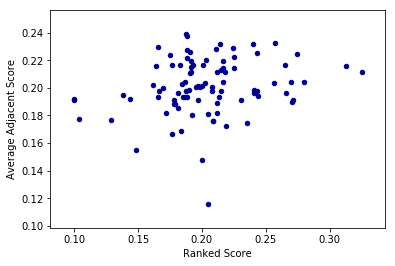

In [65]:
scatter = sf_merged2.plot.scatter(x='Ranked Score',
                       y='Average Adjacent Score',
                       c='DarkBlue')

Looking at the point with the highest Ranked Score, we see that it is still higher than a majority of other points in terms of Average Adjacent Score. Looking at the point with the highest Average Adjacent Score, we can see that it falls well short in terms of Ranked Score.

In [51]:
# set number of clusters
kclusters = 5

sf_merged2_clustering = sf_merged2.drop(['Neighborhood','Latitude','Longitude',
                                         '1st Most Common Venue','2nd Most Common Venue','3rd Most Common Venue',
                                         '4th Most Common Venue','5th Most Common Venue'], 1)
print(sf_merged2_clustering.head())
# run k-means clustering
kmeans2 = KMeans(n_clusters=kclusters, random_state=0).fit(sf_merged2_clustering)

# check cluster labels generated for each row in the dataframe
kmeans2.labels_[0:10] 

   Ranked Score  Average Adjacent Score
0      0.178500                0.188316
1      0.103571                0.177177
2      0.100000                0.191685
3      0.166486                0.197849
4      0.208681                0.175613


array([1, 0, 0, 1, 3, 3, 1, 4, 4, 2], dtype=int32)

In [52]:
# add clustering labels
sf_merged2.insert(0, 'Cluster Labels', kmeans2.labels_)

In [53]:
sf_merged2 = sf_merged2.reset_index()
sf_merged2.head()

,index,Cluster Labels,Neighborhood,Latitude,Longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Ranked Score,Average Adjacent Score
0,0,1,Alamo Square,37.776076,-122.433919,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment,0.178500,0.188316
1,1,0,Anza Vista,37.780611,-122.443255,Shop & Service,Transit,Food,Outdoors & Recreation,Arts & Entertainment,0.103571,0.177177
2,2,0,Balboa Terrace,37.730649,-122.468267,Shop & Service,Transit,Food,Arts & Entertainment,Outdoors & Recreation,0.100000,0.191685
3,3,1,Bayview,37.732391,-122.387170,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment,0.166486,0.197849
4,4,3,Bernal Heights,37.740230,-122.415885,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment,Transit,0.208681,0.175613


In [54]:
# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

map_clusters.choropleth(
    data=sf_merged2,
    geo_data=sf_geo,
    reset=True,
    name='choropleth',
    columns=['Neighborhood','Ranked Score','Average Adjacent Score'],
    key_on='feature.properties.nbrhood',
    fill_color='RdPu',
    legend_name='Neighborhood Ranking',
    highlight=True
)

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(sf_merged2['Latitude'], sf_merged2['Longitude'], sf_merged2['Neighborhood'], sf_merged2['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_clusters)

legend_html =   '''
                <div style="position: fixed; 
                            bottom: 100px; left: 50px; width: 100px; height: 190px; 
                            border:2px solid grey; z-index:9999; font-size:14px;
                            ">&nbsp; Clusters <br>
                              &nbsp; 0 &nbsp; <i class="fa fa-circle fa-2x" style="color:{}"></i><br>
                              &nbsp; 1 &nbsp; <i class="fa fa-circle fa-2x" style="color:{}"></i><br>
                              &nbsp; 2 &nbsp; <i class="fa fa-circle fa-2x" style="color:{}"></i><br>
                              &nbsp; 3 &nbsp; <i class="fa fa-circle fa-2x" style="color:{}"></i><br>
                              &nbsp; 4 &nbsp; <i class="fa fa-circle fa-2x" style="color:{}"></i>
                </div>
                '''.format(rainbow[-1],rainbow[0],rainbow[1],rainbow[2],rainbow[3])

map_clusters.get_root().html.add_child(folium.Element(legend_html))
    
       
map_clusters

In [55]:
sf_merged2 = sf_merged2.set_index(['Neighborhood'])
sf_merged2.head()

,index,Cluster Labels,Latitude,Longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Ranked Score,Average Adjacent Score
Neighborhood,,,,,,,,,,,
Alamo Square,0,1,37.776076,-122.433919,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment,0.178500,0.188316
Anza Vista,1,0,37.780611,-122.443255,Shop & Service,Transit,Food,Outdoors & Recreation,Arts & Entertainment,0.103571,0.177177
Balboa Terrace,2,0,37.730649,-122.468267,Shop & Service,Transit,Food,Arts & Entertainment,Outdoors & Recreation,0.100000,0.191685
Bayview,3,1,37.732391,-122.387170,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment,0.166486,0.197849
Bernal Heights,4,3,37.740230,-122.415885,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment,Transit,0.208681,0.175613


In [68]:
sf_merged2[['Ranked Score','Average Adjacent Score']].sort_values(by=['Ranked Score'],ascending=False).head()

,Ranked Score,Average Adjacent Score
Neighborhood,,
Golden Gate Heights,0.325000,0.211571
Forest Knolls,0.313158,0.216164
Ingleside Heights,0.279730,0.204443
Lincoln Park,0.274490,0.224153
Twin Peaks,0.271739,0.191271


Now we see that Forest Knolls certainly has a higher Average Adjacent score than Lake Shore, so it would be a good recommendation for the target audience, a couple that prefers Outdoors & Recreation as well as Food and Transit. We also see that all of these neighborhoods with high Ranked Scores are in the same cluster, and we can further explore the data by looking at each cluster.

In [57]:
sf_merged2.loc[sf_merged2['Cluster Labels'] == 0, sf_merged2.columns[[0] + list(range(3, sf_merged2.shape[1]))]].sort_values(by=['Ranked Score'],ascending=False)

,index,Longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Ranked Score,Average Adjacent Score
Neighborhood,,,,,,,,,
Jordan Park / Laurel Heights,35,-122.452730,Shop & Service,Food,Outdoors & Recreation,Transit,Arts & Entertainment,0.148077,0.154887
Crocker Amazon,11,-122.437929,Shop & Service,Food,Transit,Arts & Entertainment,Outdoors & Recreation,0.143902,0.191773
Silver Terrace,72,-122.399886,Shop & Service,Outdoors & Recreation,Arts & Entertainment,Transit,Food,0.138095,0.194734
Presidio Heights,68,-122.455418,Shop & Service,Transit,Food,Arts & Entertainment,Outdoors & Recreation,0.128431,0.176567
Anza Vista,1,-122.443255,Shop & Service,Transit,Food,Outdoors & Recreation,Arts & Entertainment,0.103571,0.177177
Balboa Terrace,2,-122.468267,Shop & Service,Transit,Food,Arts & Entertainment,Outdoors & Recreation,0.100000,0.191685
Merced Manor,44,-122.478570,Shop & Service,Transit,Outdoors & Recreation,Food,Arts & Entertainment,0.100000,0.191185


In [58]:
sf_merged2.loc[sf_merged2['Cluster Labels'] == 1, sf_merged2.columns[[0] + list(range(3, sf_merged2.shape[1]))]].sort_values(by=['Ranked Score'],ascending=False)

,index,Longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Ranked Score,Average Adjacent Score
Neighborhood,,,,,,,,,
Inner Sunset,34,-122.470358,Food,Transit,Shop & Service,Outdoors & Recreation,Arts & Entertainment,0.203077,0.219869
Yerba Buena,18,-122.400341,Transit,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment,0.202264,0.203343
Outer Richmond,59,-122.500636,Food,Shop & Service,Transit,Outdoors & Recreation,Arts & Entertainment,0.201154,0.216230
Parkside,62,-122.485278,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment,0.200376,0.201293
North Waterfront,55,-122.403837,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment,0.198193,0.200551
Potrero Hill,66,-122.399333,Shop & Service,Transit,Outdoors & Recreation,Food,Arts & Entertainment,0.196918,0.201655
Nob Hill,91,-122.415424,Shop & Service,Transit,Outdoors & Recreation,Food,Arts & Entertainment,0.196689,0.190829
Lakeside,39,-122.473853,Transit,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment,0.195745,0.200280
Westwood Highlands,82,-122.456054,Shop & Service,Transit,Outdoors & Recreation,Food,Arts & Entertainment,0.192857,0.216337


In [59]:
sf_merged2.loc[sf_merged2['Cluster Labels'] == 2, sf_merged2.columns[[0] + list(range(3, sf_merged2.shape[1]))]].sort_values(by=['Ranked Score'],ascending=False)

,index,Longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Ranked Score,Average Adjacent Score
Neighborhood,,,,,,,,,
Golden Gate Heights,23,-122.469264,Outdoors & Recreation,Transit,Shop & Service,Food,Arts & Entertainment,0.325000,0.211571
Forest Knolls,21,-122.458617,Outdoors & Recreation,Transit,Shop & Service,Food,Arts & Entertainment,0.313158,0.216164
Ingleside Heights,29,-122.467062,Outdoors & Recreation,Food,Transit,Shop & Service,Arts & Entertainment,0.279730,0.204443
Lincoln Park,84,-122.512026,Outdoors & Recreation,Arts & Entertainment,Food,Transit,Shop & Service,0.274490,0.224153
Twin Peaks,77,-122.444987,Outdoors & Recreation,Transit,Shop & Service,Food,Arts & Entertainment,0.271739,0.191271
Pine Lake Park,64,-122.484670,Outdoors & Recreation,Arts & Entertainment,Transit,Food,Shop & Service,0.270833,0.189424
Mission Bay,48,-122.391428,Food,Outdoors & Recreation,Shop & Service,Transit,Arts & Entertainment,0.270082,0.204063
Presidio,67,-122.464601,Outdoors & Recreation,Arts & Entertainment,Transit,Shop & Service,Food,0.265574,0.196499
Corona Heights,9,-122.439699,Outdoors & Recreation,Transit,Shop & Service,Food,Arts & Entertainment,0.264894,0.216667


In [60]:
sf_merged2.loc[sf_merged2['Cluster Labels'] == 3, sf_merged2.columns[[0] + list(range(3, sf_merged2.shape[1]))]].sort_values(by=['Ranked Score'],ascending=False)

,index,Longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Ranked Score,Average Adjacent Score
Neighborhood,,,,,,,,,
Buena Vista Park/Ashbury Heights,5,-122.444167,Transit,Outdoors & Recreation,Shop & Service,Food,Arts & Entertainment,0.235417,0.174713
Western Addition,81,-122.431646,Shop & Service,Outdoors & Recreation,Transit,Food,Arts & Entertainment,0.219027,0.172024
Excelsior,16,-122.428677,Shop & Service,Food,Outdoors & Recreation,Transit,Arts & Entertainment,0.211852,0.181636
Mission Dolores,49,-122.425109,Shop & Service,Food,Outdoors & Recreation,Transit,Arts & Entertainment,0.211504,0.188890
Portola,65,-122.412617,Food,Shop & Service,Transit,Outdoors & Recreation,Arts & Entertainment,0.209036,0.175922
Bernal Heights,4,-122.415885,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment,Transit,0.208681,0.175613
Lower Pacific Heights,41,-122.435863,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment,0.205056,0.116001
Hayes Valley,26,-122.427147,Shop & Service,Food,Transit,Outdoors & Recreation,Arts & Entertainment,0.204608,0.181092
Ingleside Terrace,30,-122.468368,Shop & Service,Outdoors & Recreation,Food,Arts & Entertainment,Transit,0.200000,0.147872


In [61]:
sf_merged2.loc[sf_merged2['Cluster Labels'] == 4, sf_merged2.columns[[0] + list(range(3, sf_merged2.shape[1]))]].sort_values(by=['Ranked Score'],ascending=False)

,index,Longitude,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,Ranked Score,Average Adjacent Score
Neighborhood,,,,,,,,,
Golden Gate Park,24,-122.483389,Outdoors & Recreation,Arts & Entertainment,Transit,Food,Shop & Service,0.243836,0.194046
Merced Heights,43,-122.467541,Outdoors & Recreation,Transit,Shop & Service,Arts & Entertainment,Food,0.242857,0.225058
Saint Francis Wood,70,-122.465319,Outdoors & Recreation,Transit,Shop & Service,Food,Arts & Entertainment,0.242857,0.198029
Glen Park,22,-122.435731,Outdoors & Recreation,Shop & Service,Transit,Food,Arts & Entertainment,0.241045,0.196328
Westwood Park,83,-122.456245,Food,Shop & Service,Outdoors & Recreation,Transit,Arts & Entertainment,0.240625,0.198757
Sea Cliff,71,-122.490596,Transit,Outdoors & Recreation,Shop & Service,Food,Arts & Entertainment,0.240000,0.231557
Diamond Heights,12,-122.442172,Outdoors & Recreation,Shop & Service,Transit,Food,Arts & Entertainment,0.230882,0.190909
Little Hollywood,90,-122.399378,Transit,Food,Shop & Service,Outdoors & Recreation,Arts & Entertainment,0.225000,0.222037
Monterey Heights,37,-122.460877,Outdoors & Recreation,Arts & Entertainment,Transit,Shop & Service,Food,0.225000,0.214463


We can see from these clusters that they have a range of Ranked Score which each neighborhood falls within. In the case of the analysis above, we can conclude that cluster 2 has the highest Ranked Scores due to the prevalence of Outdoors & Recreation, which is highly weighted.

## Evaluation

Now that we've run k-means clustering on Ranked Score and Average Adjacent Score, we can see that Golden Gate Heights stands out in terms of Outdoors & Recreation, Food, and Transit. However, how can we be sure that this is a meaningful recommendation? To reach a conclusion, we need to evaluate our results. I will do that by first determining the best number of clusters and then by calculating the average distance within each cluster.

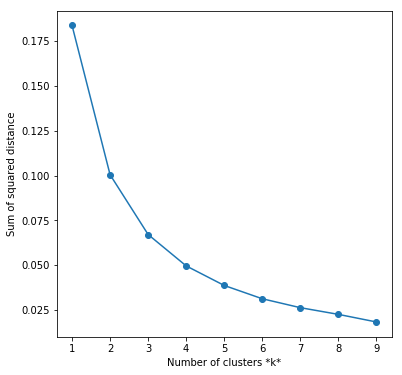

In [62]:
# Borrowed from https://towardsdatascience.com/k-means-clustering-algorithm-applications-evaluation-methods-and-drawbacks-aa03e644b48a

from matplotlib import pyplot as plt
sse = []
list_k = list(range(1, 10))

for k in list_k:
    km = KMeans(n_clusters=k)
    km.fit(sf_merged2_clustering)
    sse.append(km.inertia_)

# Plot sse against k
plt.figure(figsize=(6, 6))
plt.plot(list_k, sse, '-o')
plt.xlabel(r'Number of clusters *k*')
plt.ylabel('Sum of squared distance');

The plot above does not have have an obvious elbow in it, though we can see that as k increases, there are diminishing returns on the sum of squared distance between each cluster centroid and its members.